# Will a song be a hit?
#### Predicting whether a song will be a hit by using it's features 

##### Created by Adi Ovadia and Dana Zidon

# Introduction
Our approach involves constructing a composite dataset by integrating information from two distinct sources: a dataset comprising information about songs, and another containing information about artists. Next, we will leverage this composite dataset to construct a measure of popularity based on an aggregation of information from three separate datasets that capture information about music charts and awards. This measure will serve as a comprehensive metric of popularity that accounts for various factors that contribute to an artist's or song's success.

# Table of Contents

### 1 [Data](#section1)
### 2 [Visualizations](#section2)
### 3 [Pre-processing](#section3)
### 4 [Predictions](#section4)
### 5 [Preformance Evaluation](#section5)



# Data <a class="anchor" id="section1"></a>

### artistDf
##### Information about artists 
* **Artist** - The name of an artist 
* **Followers** - The number of followers the artist have
* **Genres** - The artist's genres 
* **NumAlbums** - The number of albumns the artist made
* **YearFirstAlbum** - The year of the artist's first album 
* **Gender** - The artist's gender 
* **Group.Solo** - Whether the artist is part of a band or in solo career 

### songAttributes
##### Various features on songs
* **Acousticness** - The degree to which a piece of music is made up of acoustic (non-electronic) instruments or sounds, as opposed to synthesized or electronically-produced sounds
* **Album** - The name of the album the song is in
* **Artist** - The name of the artist the preforming the song
* **Danceability** - How suitable a piece of music is for dancing
* **Duration** - The dutation of the song in ms 
* **Energy** - The perceived level of intensity, excitement, or emotion conveyed by the music
* **Explicit** - Whether the song has curse words or language or art that is generally deemed sexual, violent, or offensive in nature
* **Instrumentalness** - The amount of vocals in the song
* **Liveness** - The reverberation time
* **Loudness** - The subjective perception of sound pressure
* **Mode** - Any of several ways of ordering the notes of a scale according to the intervals they form with the tonic
* **Name** - The name of the song
* **Popularity** - 
* **Speechiness** - Detects the presence of spoken words in a track
* **Tempo** - How fast or slow a piece of music is performed
* **TimeSignature** - How many of a particular note value are contained in each measure
* **Valence** - The musical positiveness conveyed by a track



We have 3 more datasets of charts in rewards and we are going to use them to improve the popularity score accuracy

### Imports

In [1]:
# Import libraries
#import spotipy
#from spotipy.oauth2 import SpotifyOAuth
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd 
from sklearn.preprocessing import StandardScaler
import numpy as np
from sklearn.impute import KNNImputer
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.feature_selection import SelectKBest, f_classif
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.metrics import confusion_matrix, roc_curve, auc, precision_score, recall_score, f1_score, matthews_corrcoef
from sklearn.model_selection import cross_val_score, GridSearchCV
from sklearn.linear_model import Lasso
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import xgboost as xgb
from sklearn.model_selection import cross_val_predict
from sklearn.preprocessing import LabelEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import classification_report
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)


# Load the datasets
artistDf = pd.read_csv('artistDf.csv').drop('X', axis=1)
songAttributes = pd.read_csv('songAttributes_1999-2019.csv',encoding='latin-1').drop('Unnamed: 0', axis=1)
spotifyWeeklyTop = pd.read_csv('spotifyWeeklyTop200Streams.csv',encoding='latin-1').drop('Unnamed: 0', axis=1)
riaaSingleCerts = pd.read_csv('riaaSingleCerts_1999-2019.csv',encoding='latin-1').drop('X', axis=1)
charts = pd.read_csv('charts.csv',encoding='latin-1')

# Visualizations <a class="anchor" id="section2"></a>

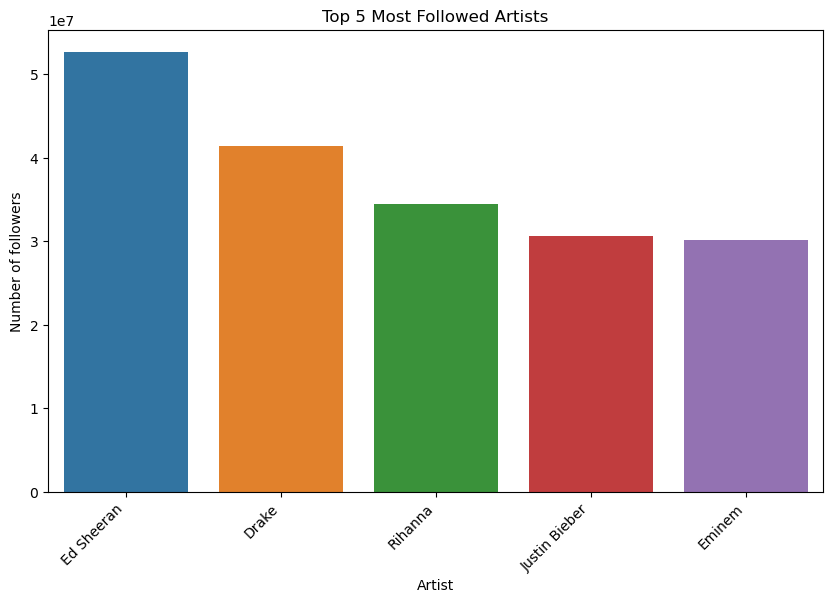

In [2]:
top_artists = artistDf.sort_values('Followers', ascending=False).head(5)

plt.figure(figsize=(10, 6))
sns.barplot(x='Artist', y='Followers', data=top_artists)
plt.xticks(rotation=45, ha='right')
plt.xlabel('Artist')
plt.ylabel('Number of followers')
plt.title('Top 5 Most Followed Artists')
plt.show()

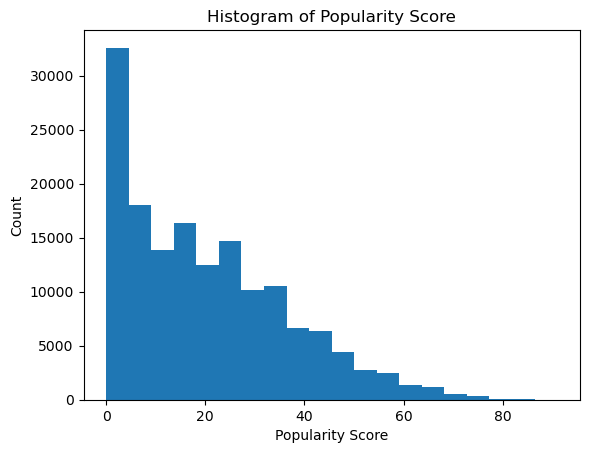

In [3]:
# Create histogram of popularity score
plt.hist(songAttributes['Popularity'], bins=20)
plt.xlabel('Popularity Score')
plt.ylabel('Count')
plt.title('Histogram of Popularity Score')
plt.show()

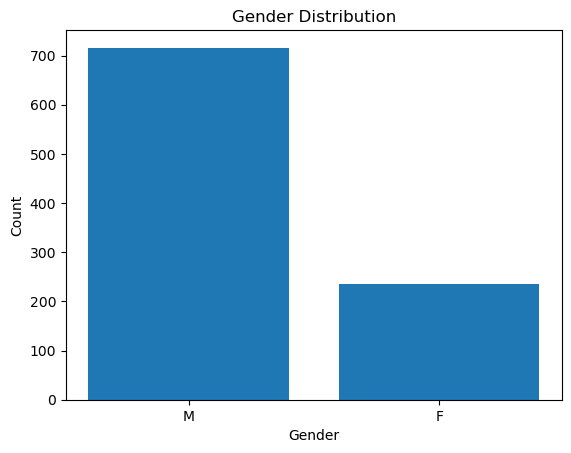

In [4]:
gender_counts = artistDf['Gender'].value_counts()

plt.bar(gender_counts.index, gender_counts.values)
plt.title('Gender Distribution')
plt.xlabel('Gender')
plt.ylabel('Count')
plt.show()

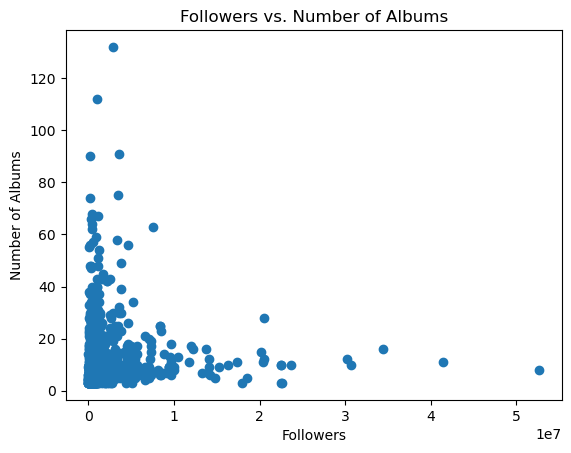

In [5]:
plt.scatter(artistDf['Followers'], artistDf['NumAlbums'])
plt.title('Followers vs. Number of Albums')
plt.xlabel('Followers')
plt.ylabel('Number of Albums')
plt.show()

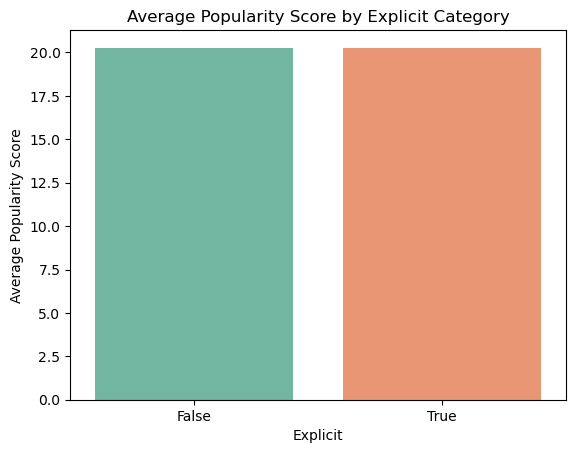

In [6]:
# Group songs by explicit category and calculate the mean popularity score for each category
explicit_grouped = songAttributes.groupby("Explicit")["Popularity"].mean().reset_index()

# Create bar chart
sns.barplot(data=explicit_grouped, x="Explicit", y="Popularity", palette="Set2")

# Set plot labels and title
plt.xlabel("Explicit")
plt.ylabel("Average Popularity Score")
plt.title("Average Popularity Score by Explicit Category")

# Show plot
plt.show()

<AxesSubplot:title={'center':'Weeks In The Chart'}, ylabel='Frequency'>

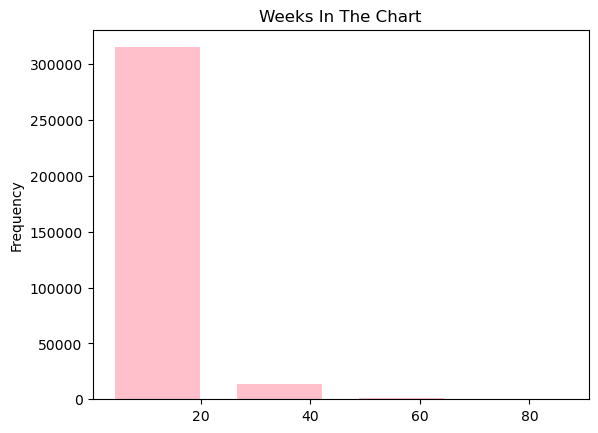

In [7]:
#plot of the peaks the song was in the chart 
charts['weeks-on-board'].plot(kind='hist',bins=4,rwidth=0.7,color="pink",title="Weeks In The Chart")

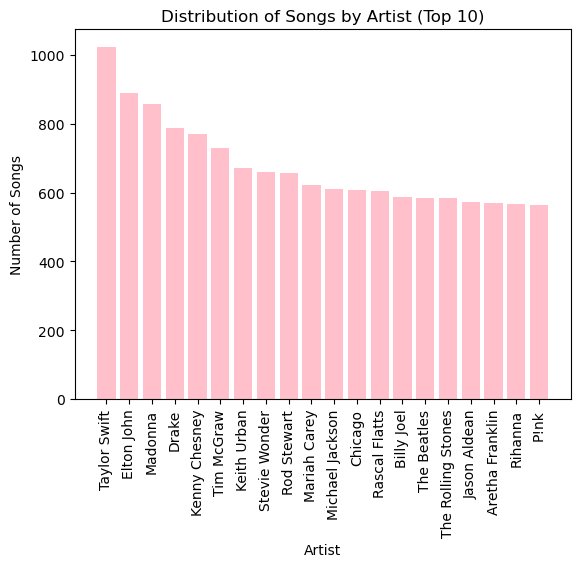

In [8]:
# Get the count of songs by artist and only keep the top 10
artist_data = charts.groupby('artist')['song'].count().reset_index().nlargest(20, 'song')

# Create a bar chart
plt.bar(artist_data['artist'], artist_data['song'],color="pink")
plt.xticks(rotation=90)
plt.xlabel('Artist')
plt.ylabel('Number of Songs')
plt.title('Distribution of Songs by Artist (Top 10)')
plt.show()

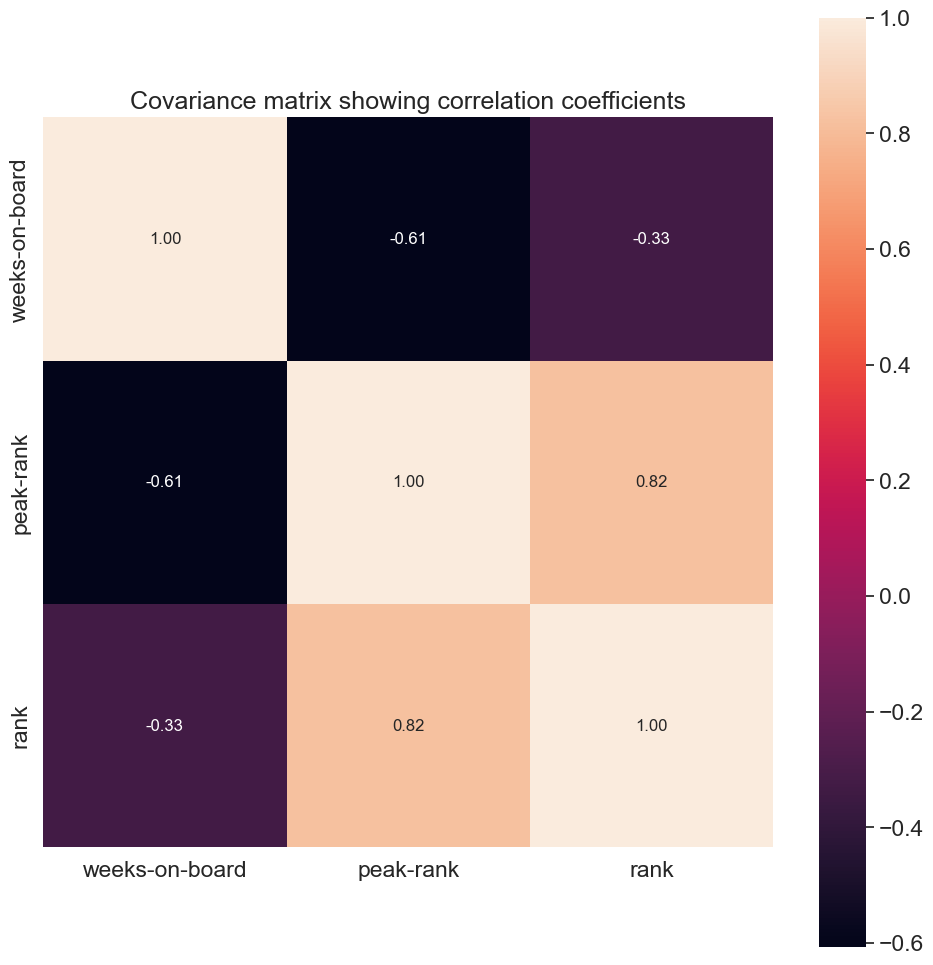

In [9]:
# Specify the columns to use for the covariance matrix analysis
cols = ['weeks-on-board', 'peak-rank',  'rank']

# Standardize the selected columns using the StandardScaler
stdsc = StandardScaler()
X_std = stdsc.fit_transform(charts[cols].values)

# Compute the covariance matrix
cov_mat = np.cov(X_std.T)

# Create a heatmap of the covariance matrix using seaborn
plt.figure(figsize=(10, 10))
sns.set(font_scale=1.5)
hm = sns.heatmap(cov_mat,
                 cbar=True,
                 annot=True,
                 square=True,
                 fmt='.2f',
                 annot_kws={'size': 12},
                 yticklabels=cols,
                 xticklabels=cols)
plt.title('Covariance matrix showing correlation coefficients')
plt.tight_layout()
plt.show()

# Pre-processing <a class="anchor" id="section3"></a>

In [10]:
# create a list of tuples containing the name of each dataframe and its shape
shapes = [('artistDf', artistDf.shape), ('songAttributes', songAttributes.shape), ('spotifyWeeklyTop', spotifyWeeklyTop.shape), ('riaaSingleCerts', riaaSingleCerts.shape),('charts', charts.shape)]

# create a new dataframe from the list of tuples
shape_table = pd.DataFrame(shapes, columns=['Dataframe ', '  Rows, Columns'])

# print the table
print(shape_table)

         Dataframe    Rows, Columns
0          artistDf       (1035, 7)
1    songAttributes    (154931, 17)
2  spotifyWeeklyTop      (26395, 5)
3   riaaSingleCerts       (2601, 4)
4            charts     (330087, 7)


In [11]:
#merge the DataFrames
merged_df = pd.merge(artistDf,songAttributes, on='Artist', how='outer')

In [12]:
merged_df.describe()

,Followers,NumAlbums,YearFirstAlbum,Acousticness,Danceability,Duration,Energy,Instrumentalness,Liveness,Loudness,Mode,Popularity,Speechiness,Tempo,TimeSignature,Valence
count,1.512860e+05,151286.000000,151286.000000,155467.000000,155467.000000,1.554670e+05,155467.000000,155467.000000,155467.000000,155467.000000,155467.000000,155467.000000,155467.000000,155467.000000,155467.000000,155467.00000
mean,2.154393e+06,21.365738,1993.509214,0.267063,0.575436,2.323596e+05,0.637975,0.062800,0.254025,-8.035522,0.683888,20.227978,0.122158,119.210543,3.904192,0.49824
std,4.235892e+06,20.887723,15.747626,0.300602,0.167788,1.203401e+05,0.232926,0.199350,0.231826,4.163428,0.464959,16.496030,0.151891,30.978043,0.467403,0.24034
min,7.750000e+02,3.000000,1929.000000,0.000000,0.000000,1.731000e+03,0.000000,0.000000,0.000000,-60.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
25%,2.873210e+05,8.000000,1991.000000,0.020400,0.468000,1.888530e+05,0.481000,0.000000,0.102000,-9.869000,0.000000,6.000000,0.034800,94.359500,4.000000,0.30800
50%,7.859800e+05,14.000000,1998.000000,0.129000,0.586000,2.246670e+05,0.677000,0.000003,0.153000,-7.000000,1.000000,17.000000,0.052600,118.838000,4.000000,0.49800
75%,2.223790e+06,26.000000,2004.000000,0.455000,0.697000,2.635215e+05,0.829000,0.000855,0.326000,-5.170000,1.000000,31.000000,0.145000,139.817000,4.000000,0.68800
max,5.269876e+07,132.000000,2011.000000,0.996000,0.987000,4.795973e+06,1.000000,0.998000,1.000000,3.515000,1.000000,91.000000,0.969000,248.060000,5.000000,0.99500


### Cleaning and Filtering

In [13]:
#deleting non informative columns
merged_df = merged_df.drop(['YearFirstAlbum', 'Album'], axis=1)

### Filling missing values

In [14]:
merged_df.isnull().sum()/len(merged_df)

Artist              0.000000
Followers           0.027306
Genres              0.038609
NumAlbums           0.027306
Gender              0.082008
Group.Solo          0.035510
Acousticness        0.000424
Danceability        0.000424
Duration            0.000424
Energy              0.000424
Explicit            0.000424
Instrumentalness    0.000424
Liveness            0.000424
Loudness            0.000424
Mode                0.000424
Name                0.000424
Popularity          0.000424
Speechiness         0.000424
Tempo               0.000424
TimeSignature       0.000424
Valence             0.000424
dtype: float64

We decided to drop all the rows that have missing values in columns that have small precentage of missing values

In [15]:
# calculate the percentage of null values in each column
null_percentages = merged_df.isnull().sum() / len(merged_df)

# get the list of column names with less than or equal to 0.04 null values
selected_columns = null_percentages[(null_percentages > 0.0) & (null_percentages < 0.0005)].index.tolist()

# drop all rows that have missing values in these columns
merged_df = merged_df.dropna(subset=selected_columns)

We also decided to drop the rows that have missing value in the Group.solo feature beacuse we noticed they are fictional characters 

In [16]:
merged_df.dropna(subset=['Group.Solo'], inplace=True)

We also noticed that where there are missing values in the "Gender" column - its beacuse its a band with both famale and male. so we decided to add the paramter - B, meaning Both. and replace to it

In [17]:
merged_df['Gender'].fillna('B', inplace=True)

In [18]:
numeric_features = merged_df.select_dtypes(include='number').drop(['Mode','TimeSignature'], axis=1)

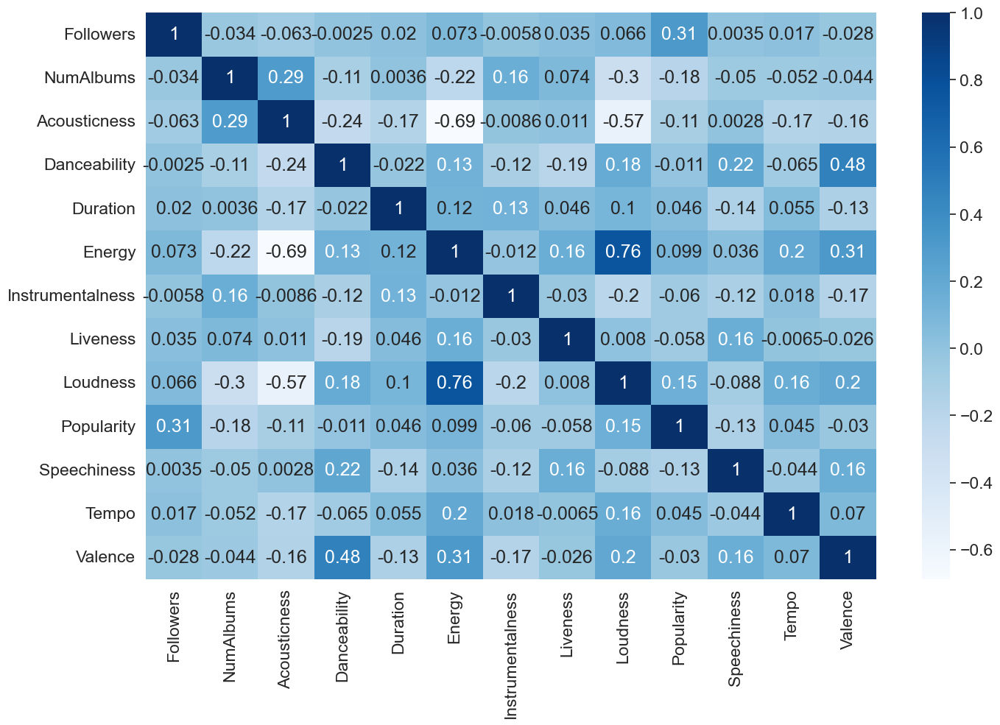

In [19]:
#checking corroletios in the df
plt.figure(figsize=(16, 10))
sns.heatmap(numeric_features.corr(), annot=True, cmap='Blues')
plt.show()

We can see that Energy and Loudness have high correlation so we decided to drop one of them, we decided to keep the Loudness feature beacuse it has higher correlation with populairty


In [20]:
merged_df = merged_df.drop(['Energy'], axis=1)

### Creating our features and improving popularity score 

In [21]:
merged_df["Was on billboard"] = merged_df["Name"].isin(charts["song"]).astype(int)
merged_df["Won reward"] = merged_df["Name"].isin(riaaSingleCerts["Name"]).astype(int)

In [22]:
merged_df.loc[merged_df['Name'].isin(charts['song']), 'Popularity'] += charts.loc[charts['song'].isin(merged_df['Name']), 'weeks-on-board'].reset_index(drop=True)

In [23]:
def convert_certification_to_score(certification):
    """
    Convert a certification string to a score based on mapping.
    """
    mapping = {
        "Gold": 5,
        "Platinum": 10,
        "multi-Platinum": 20,
        "Diamond": 100
    }
    if certification.endswith("x Diamond"):
        num = int(certification.split("x")[0])
        return num * 10
    elif certification.endswith("x Multi-Platinum"):
        num = int(certification.split("x")[0])
        return num * 2
    elif certification.endswith("x Platinum"):
        num = int(certification.split("x")[0])
        return num * 1
    elif certification in mapping:
        return mapping[certification]

In [24]:
riaaSingleCerts["score"] = riaaSingleCerts["RiaaStatus"].apply(convert_certification_to_score)

In [25]:
merged_df = merged_df.merge(riaaSingleCerts[['Name', 'score']], on='Name', how='left')
merged_df['score'] = merged_df['score'].fillna(0)
merged_df['Popularity'] = merged_df['Popularity'] + merged_df['score']

merged_df.drop('score', axis=1, inplace=True)

### Exploring outliers

In [26]:
# list of column names to change data type to category
cat_columns = ['Mode', 'Was on billboard', 'Won reward','TimeSignature']

# iterate over column names and change data type to category
for col in cat_columns:
    merged_df[col] = merged_df[col].astype('object')

numeric_features = merged_df.select_dtypes(include='number')

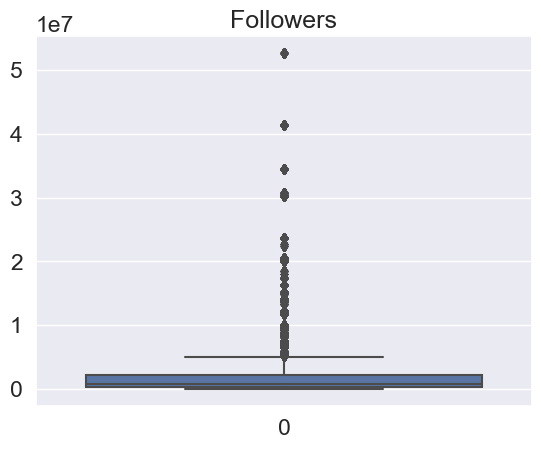

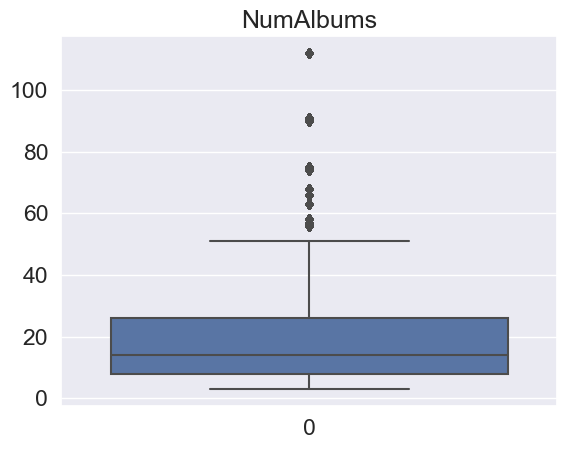

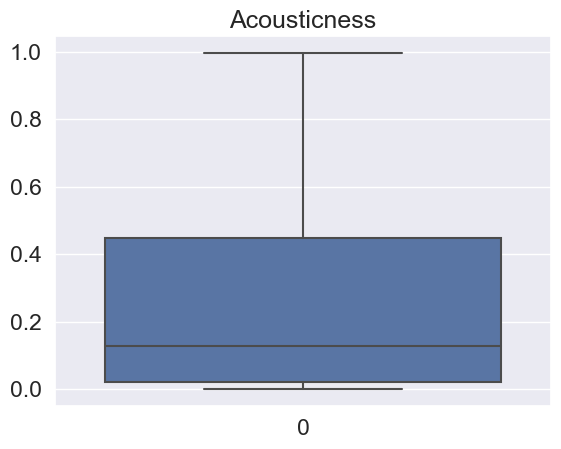

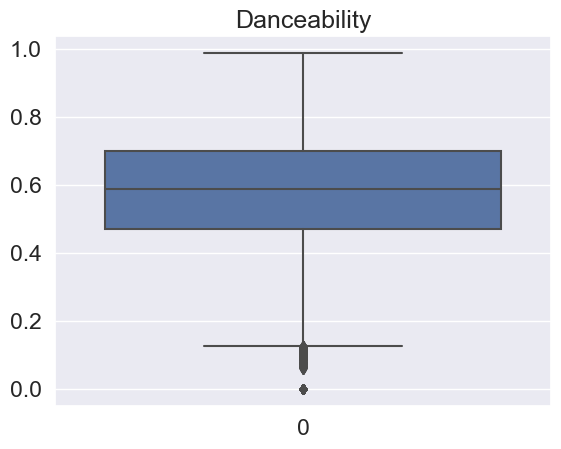

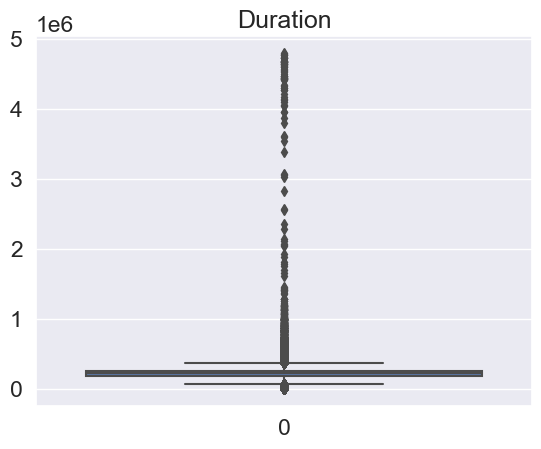

...

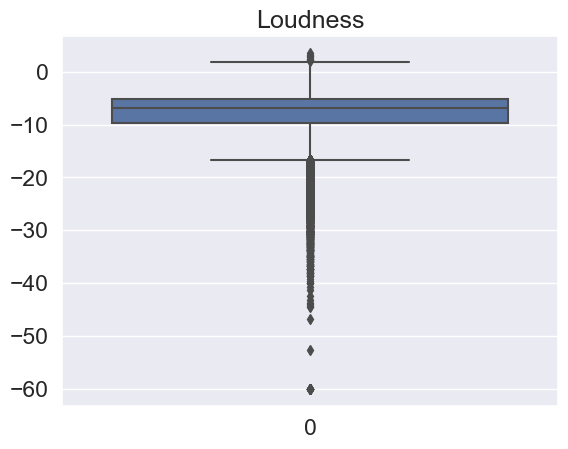

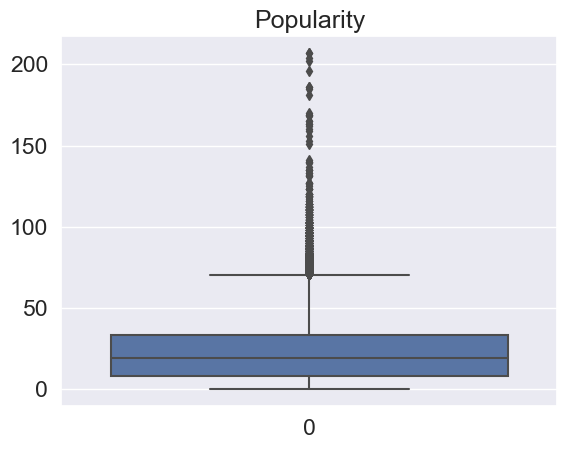

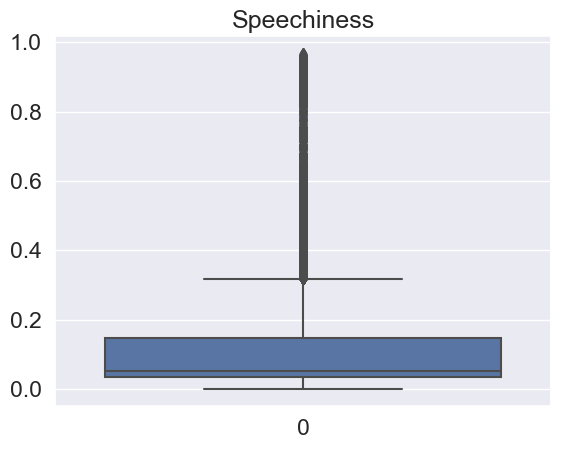

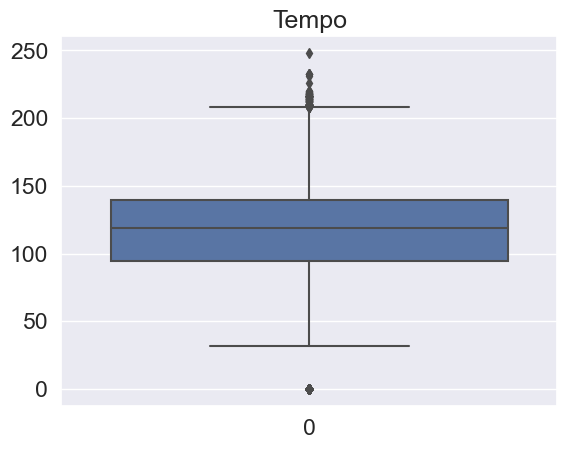

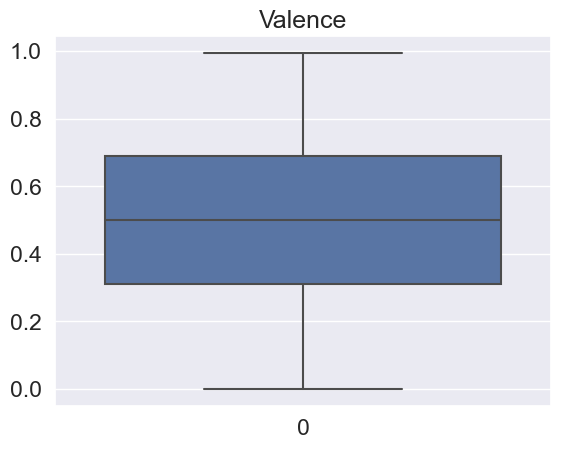

In [27]:
# Create a box plot for each numerical column
for column in numeric_features:
    plt.figure()
    sns.boxplot(data=merged_df[column])
    plt.title(column)

# Show the box plots
plt.show()


#### Handling the outliers

After careful consideration and analysis, it has been decided that the outliers present in the Followers and NumAlbums columns of the dataset will be retained as they are deemed to represent genuine data points that provide valuable insights into the distribution and characteristics of the underlying population

In [28]:
# Define the columns to remove outliers from
cols_to_remove_outliers = ['Acousticness', 'Danceability', 'Duration', 'Loudness', 'Speechiness', 'Tempo', 'NumAlbums']

# Standardize the selected columns
scaler = StandardScaler()
merged_df_scaled = scaler.fit_transform(merged_df[cols_to_remove_outliers])

# Apply PCA to the standardized data
pca = PCA()
merged_df_pca = pca.fit_transform(merged_df_scaled)

# Calculate the variance explained by each principal component
explained_variance = pca.explained_variance_ratio_

# Identify the components contributing to most of the variance
cumulative_variance = np.cumsum(explained_variance)
num_components = np.argmax(cumulative_variance >= 0.95) + 1  # Set a threshold for variance coverage (e.g., 95%)

# Retain the selected number of components
merged_df_reduced = merged_df_pca[:, :num_components]

# Inverse transform the reduced data back to the original scale
merged_df_outliers_removed = scaler.inverse_transform(merged_df_reduced)

# Assign the outlier-removed values back to the original DataFrame
merged_df[cols_to_remove_outliers] = merged_df_outliers_removed

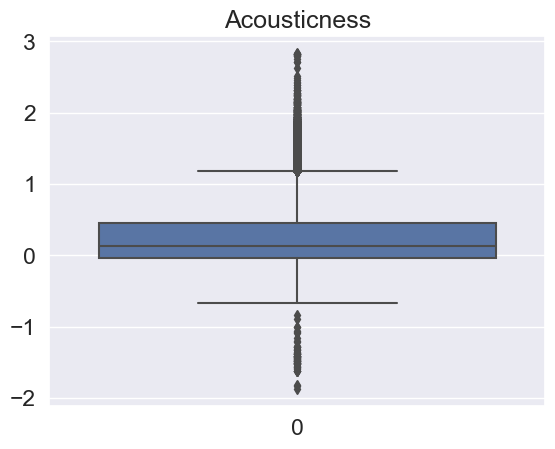

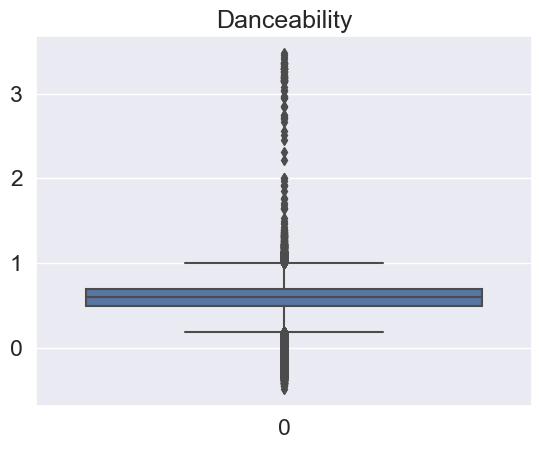

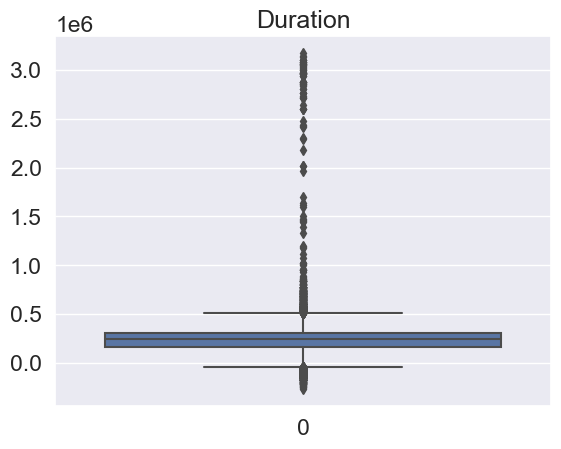

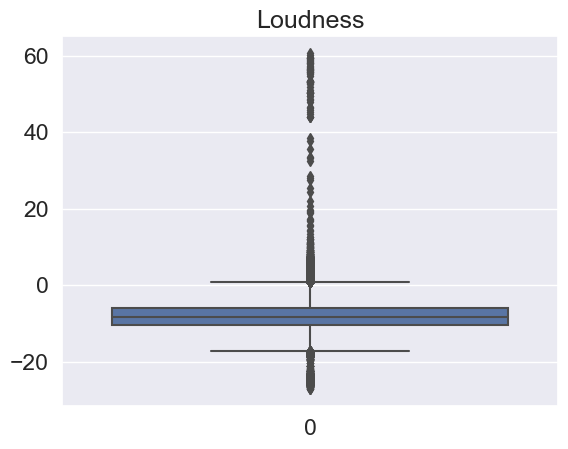

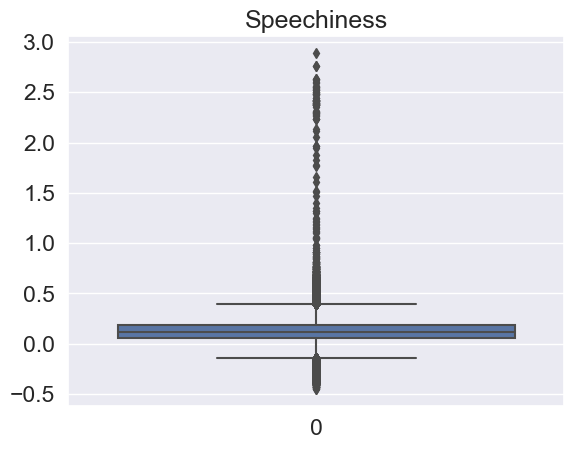

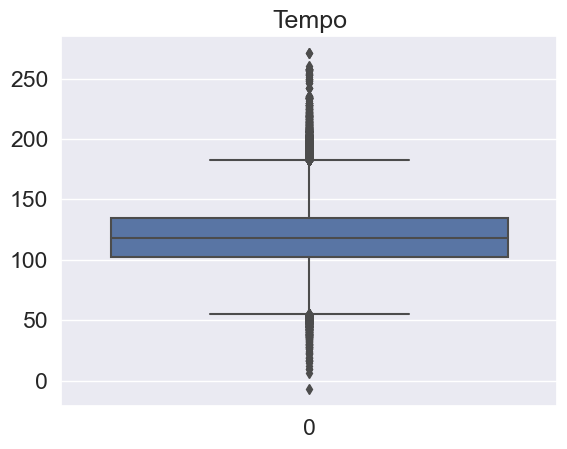

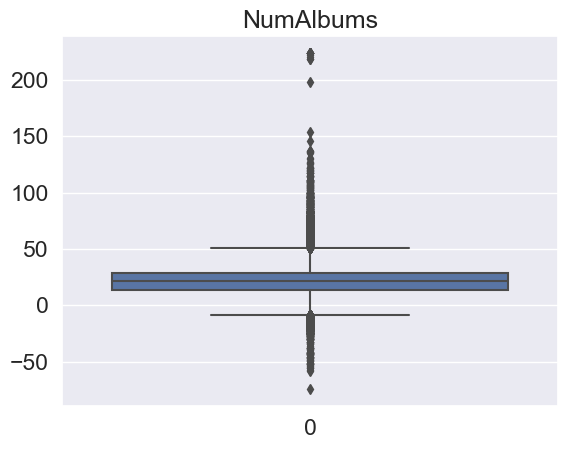

In [29]:
# Create a box plot for each numerical column
for column in cols_to_remove_outliers:
    plt.figure()
    sns.boxplot(data=merged_df[column])
    plt.title(column)

# Show the box plots
plt.show()

#### One hot encoding to categorial features 

In [30]:
categorical_features = merged_df.select_dtypes(include='object').drop(['Genres','Name'], axis=1)
cat_cols = categorical_features.columns.tolist()

# Perform one-hot encoding for all categorical columns
df_encoded = pd.get_dummies(merged_df, columns=cat_cols)

In [31]:
# Split the "Genres" column into multiple columns using one hot encoding
genres_df = df_encoded['Genres'].str.get_dummies(sep=',')

# Add a prefix to the new columns to indicate the genre
genres_df = genres_df.add_prefix('genre_')

# Calculate the frequency of each genre
genre_frequencies = genres_df.iloc[:, 0:].sum() 

# Define the percentile threshold for filtering uncommon genres
percentile_threshold = 85 

# Calculate the occurrence count threshold based on the percentile
threshold = np.percentile(genre_frequencies, percentile_threshold)

# Get the column names of genres with occurrence above the threshold
common_genres = genre_frequencies[genre_frequencies >= threshold].index.tolist()

# Remove the columns representing uncommon genres
df_filtered = genres_df[common_genres]

# Concatenate the original dataset with the new genres columns
df_encoded = pd.concat([df_encoded, df_filtered], axis=1)

# Remove the original "Genres" column
df_encoded.drop('Genres', axis=1, inplace=True)

# Get a list of columns to remove (those with 0 on ALL rows)
cols_to_remove = df_encoded.columns[(df_encoded == 0).all()]

# Add the "Name" column to the list of columns to remove
cols_to_remove = np.append(cols_to_remove, "Name")

# Remove the columns from the dataframe
df_encoded.drop(cols_to_remove, axis=1, inplace=True)

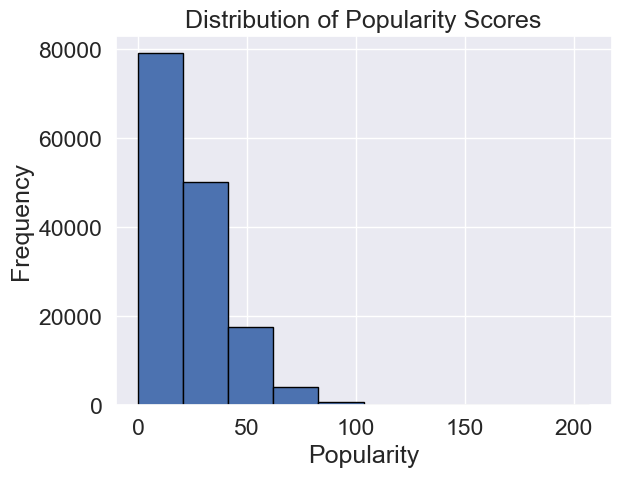

In [32]:
# Plot the histogram of Popularity scores
plt.hist(df_encoded['Popularity'], bins=10, edgecolor='black')
plt.xlabel('Popularity')
plt.ylabel('Frequency')
plt.title('Distribution of Popularity Scores')
plt.show()

In [33]:
# Calculate the popularity distribution
popularity_distribution = df_encoded['Popularity'].describe()

# Calculate the 90th percentile
percentile_90 = np.percentile(df_encoded['Popularity'], 90)

# Define the thresholds based on the distribution
thresholds = [popularity_distribution['min'], popularity_distribution['25%'], popularity_distribution['75%'],
              percentile_90, popularity_distribution['max']]

# Define the corresponding category labels
category_labels = ['Not Popular', 'Less Popular', 'Popular', 'Highly Popular']

# Create a new column 'Popularity Category' based on the score range
df_encoded['Popularity Category'] = pd.cut(df_encoded['Popularity'], bins=thresholds, labels=category_labels, right=False)

df_encoded.loc[df_encoded['Popularity'] < popularity_distribution['25%'], 'Popularity Category'] = 'Not Popular'
df_encoded.loc[(df_encoded['Popularity'] >= popularity_distribution['25%']) & (df_encoded['Popularity'] < popularity_distribution['75%']), 'Popularity Category'] = 'Less Popular'
df_encoded.loc[(df_encoded['Popularity'] >= popularity_distribution['75%']) & (df_encoded['Popularity'] < percentile_90), 'Popularity Category'] = 'Popular'
df_encoded.loc[df_encoded['Popularity'] >= percentile_90, 'Popularity Category'] = 'Highly Popular'

# Map category labels to numerical values
label_mapping = {'Not Popular': 0, 'Less Popular': 1, 'Popular': 2, 'Highly Popular': 3}
df_encoded['Popularity Category'] = df_encoded['Popularity Category'].replace(label_mapping)

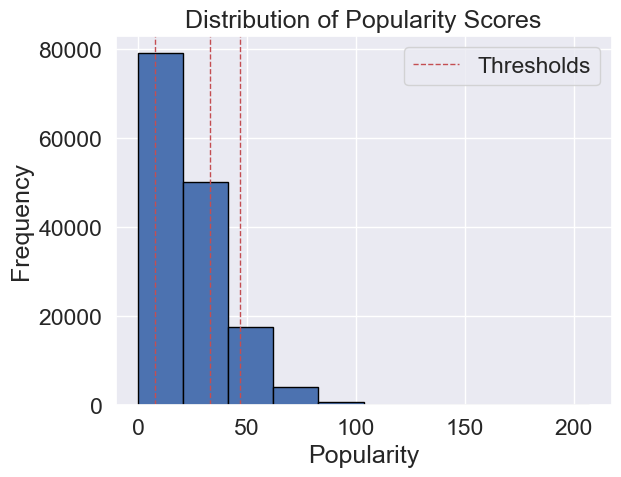

In [34]:
# Plot the histogram of Popularity scores
plt.hist(df_encoded['Popularity'], bins=10, edgecolor='black')
plt.xlabel('Popularity')
plt.ylabel('Frequency')
plt.title('Distribution of Popularity Scores')

# Remove the minimum and maximum values from the thresholds list
thresholds.remove(min(thresholds))
thresholds.remove(max(thresholds))

# Add vertical lines for the thresholds
for threshold in thresholds:
    plt.axvline(x=threshold, color='r', linestyle='--', linewidth=1)

plt.legend(['Thresholds'])
plt.show()

#### Features Improtance

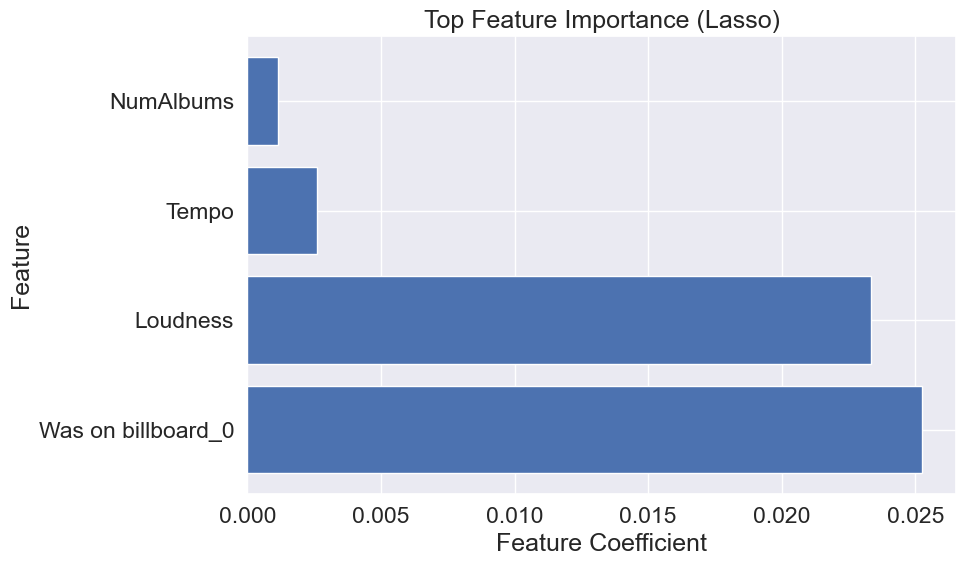

In [35]:
# Separate the features (X) and the target variable (y)
X = df_encoded.drop(['Popularity Category','Popularity'], axis=1)
y = df_encoded['Popularity Category']

# Instantiate the Lasso model
lasso_model = Lasso(alpha=0.1)  
# Fit the Lasso model to the data
lasso_model.fit(X, y)

# Get the feature coefficients
feature_coefficients = lasso_model.coef_

# Get the absolute feature coefficients
abs_feature_coefficients = np.abs(feature_coefficients)

# Sort the feature coefficients in descending order
sorted_indices = np.argsort(abs_feature_coefficients)[::-1]
sorted_feature_coefficients = abs_feature_coefficients[sorted_indices]

# Get the feature names in the original order
feature_names = X.columns
sorted_feature_names = feature_names[sorted_indices]

top_n = 4
top_feature_coefficients = sorted_feature_coefficients[:top_n]
top_feature_names = sorted_feature_names[:top_n]

# Plot the top feature coefficients
plt.figure(figsize=(10, 6))
plt.barh(top_feature_names, top_feature_coefficients)
plt.xlabel('Feature Coefficient')
plt.ylabel('Feature')
plt.title('Top Feature Importance (Lasso)')
plt.tight_layout()
plt.show()

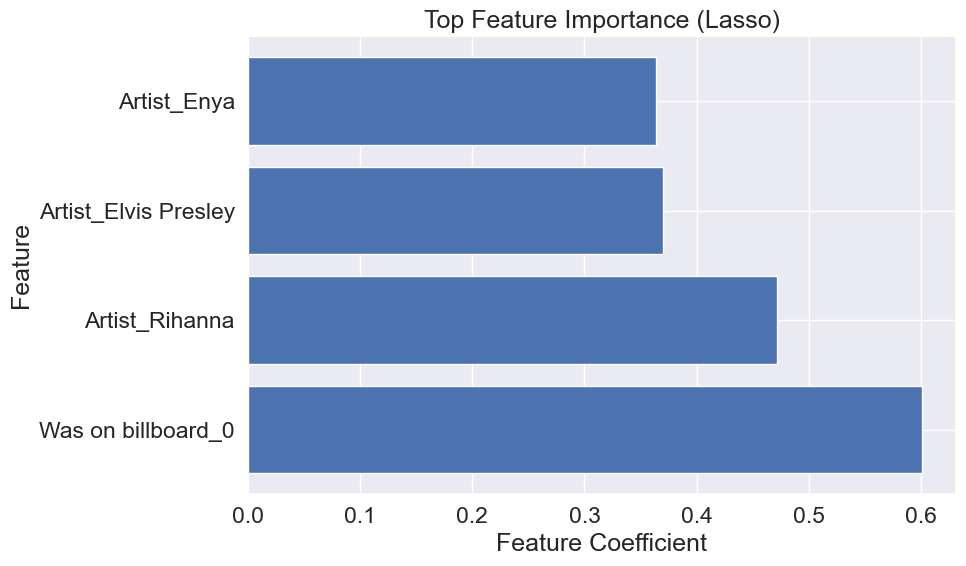

In [36]:
# Separate the features (X) and the target variable (y)
X = df_encoded.drop(['Popularity Category','Popularity'], axis=1)
y = df_encoded['Popularity Category']

# Instantiate the Lasso model
lasso_model = Lasso(alpha=0.001)  
# Fit the Lasso model to the data
lasso_model.fit(X, y)

# Get the feature coefficients
feature_coefficients = lasso_model.coef_

# Get the absolute feature coefficients
abs_feature_coefficients = np.abs(feature_coefficients)

# Sort the feature coefficients in descending order
sorted_indices = np.argsort(abs_feature_coefficients)[::-1]
sorted_feature_coefficients = abs_feature_coefficients[sorted_indices]

# Get the feature names in the original order
feature_names = X.columns
sorted_feature_names = feature_names[sorted_indices]

top_n = 4
top_feature_coefficients = sorted_feature_coefficients[:top_n]
top_feature_names = sorted_feature_names[:top_n]

# Plot the top feature coefficients
plt.figure(figsize=(10, 6))
plt.barh(top_feature_names, top_feature_coefficients)
plt.xlabel('Feature Coefficient')
plt.ylabel('Feature')
plt.title('Top Feature Importance (Lasso)')
plt.tight_layout()
plt.show()

# Get the feature names with zero coefficients
zero_coefficient_features = sorted_feature_names[sorted_feature_coefficients == 0]

# Delete columns with zero coefficient from the DataFrame
df_encoded = df_encoded.drop(zero_coefficient_features, axis=1)

# Predictions <a class="anchor" id="section4"></a>

We try to predict to which class a song will be in, using multiclass classifiers.

#### Gradiant descent - XGBoost Classifier

In [37]:
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score
import xgboost as xgb
import numpy as np

# Separate the features (X) and the target variable (y)
X = df_encoded.drop(['Popularity Category', 'Popularity'], axis=1)
y = df_encoded['Popularity Category']

# Perform label encoding on the target variable
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(y)

# Split the data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y_encoded, test_size=0.2, random_state=42)

# Convert X_train and X_test to numpy arrays
X_train_np = X_train.values
X_test_np = X_test.values

# Instantiate the XGBoost classifier
classifier = xgb.XGBClassifier()

# Perform cross-validation on the training set
cv_scores = cross_val_score(classifier, X_train_np, y_train, cv=5)

# Fit the classifier on the training data
classifier.fit(X_train_np, y_train)

# Map the encoded labels back to their original values
categories = label_encoder.inverse_transform(np.arange(len(label_encoder.classes_)))

# Print the predicted categories for each observation in the test set
for i, observation in enumerate(X_test_np):
    print(f"Observation {i+1}:")
    probabilities = classifier.predict_proba([observation])[0]
    for category, probability in zip(categories, probabilities):
        print(f"Probability of being in category '{category}': {probability:.4f}")
    print()

xgb_probs = classifier.predict_proba(X_test_np)

# Convert probabilities to class labels
xgb_pred_labels = np.argmax(xgb_probs, axis=1)

# Compute the accuracy of the model
xgb_accuracy = accuracy_score(y_test, xgb_pred_labels)

# Get the classification report with various metrics
xgb_report = classification_report(y_test, xgb_pred_labels, target_names=categories, output_dict=True)

# Print the cross-validation scores
print("Cross-Validation Scores:")
print(cv_scores)

Observation 1:
Probability of being in category '0': 0.1800
Probability of being in category '1': 0.4855
Probability of being in category '2': 0.3260
Probability of being in category '3': 0.0085

Observation 2:
Probability of being in category '0': 0.1772
Probability of being in category '1': 0.8107
Probability of being in category '2': 0.0112
Probability of being in category '3': 0.0009

Observation 3:
Probability of being in category '0': 0.2049
Probability of being in category '1': 0.6589
Probability of being in category '2': 0.1211
Probability of being in category '3': 0.0150

Observation 4:
Probability of being in category '0': 0.2091
Probability of being in category '1': 0.5878
Probability of being in category '2': 0.1147
Probability of being in category '3': 0.0884

Observation 5:
Probability of being in category '0': 0.0730
Probability of being in category '1': 0.7971
Probability of being in category '2': 0.0440
Probability of being in category '3': 0.0859

Observation 6:
Proba

#### Random Forest Classifier

In [38]:
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestClassifier
import numpy as np

# Separate the features (X) and the target variable (y)
X = df_encoded.drop(['Popularity Category', 'Popularity'], axis=1)
y = df_encoded['Popularity Category']

# Perform label encoding on the target variable
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(y)

# Split the data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y_encoded, test_size=0.2, random_state=42)

# Convert X_train and X_test to numpy arrays
X_train_np = X_train.values
X_test_np = X_test.values

# Instantiate the Random Forest classifier
classifier = RandomForestClassifier()

# Perform cross-validation on the training set
cv_scores = cross_val_score(classifier, X_train_np, y_train, cv=5)

# Fit the classifier on the training data
classifier.fit(X_train_np, y_train)

# Map the encoded labels back to their original values
categories = label_encoder.inverse_transform(np.arange(len(label_encoder.classes_)))

# Print the predicted categories for each observation in the test set
for i, observation in enumerate(X_test_np):
    print(f"Observation {i+1}:")
    probabilities = classifier.predict_proba([observation])[0]
    for category, probability in zip(categories, probabilities):
        print(f"Probability of being in category '{category}': {probability:.4f}")
    print()
    
rf_probs = classifier.predict_proba(X_test_np)

# Convert probabilities to class labels
rf_pred_labels = np.argmax(rf_probs, axis=1)

# Compute the accuracy of the model
rf_accuracy = accuracy_score(y_test, rf_pred_labels)

# Get the classification report with various metrics
rf_report = classification_report(y_test, rf_pred_labels, target_names=categories, output_dict=True)

# Print the cross-validation scores
print("Cross-Validation Scores:")
print(cv_scores)


Observation 1:
Probability of being in category '0': 0.1000
Probability of being in category '1': 0.6300
Probability of being in category '2': 0.1800
Probability of being in category '3': 0.0900

Observation 2:
Probability of being in category '0': 0.2000
Probability of being in category '1': 0.7700
Probability of being in category '2': 0.0300
Probability of being in category '3': 0.0000

Observation 3:
Probability of being in category '0': 0.2500
Probability of being in category '1': 0.6700
Probability of being in category '2': 0.0600
Probability of being in category '3': 0.0200

Observation 4:
Probability of being in category '0': 0.1000
Probability of being in category '1': 0.5900
Probability of being in category '2': 0.2800
Probability of being in category '3': 0.0300

Observation 5:
Probability of being in category '0': 0.0200
Probability of being in category '1': 0.8900
Probability of being in category '2': 0.0600
Probability of being in category '3': 0.0300

Observation 6:
Proba

#### Logistic regression 

In [39]:
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestClassifier

# Separate the features (X) and the target variable (y)
X = df_encoded.drop(['Popularity Category', 'Popularity'], axis=1)
y = df_encoded['Popularity Category']

# Perform label encoding on the target variable
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(y)

# Split the data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y_encoded, test_size=0.2, random_state=42)

# Convert X_train and X_test to numpy arrays
X_train_np = X_train.values
X_test_np = X_test.values

# Instantiate the Random Forest classifier
classifier = LogisticRegression()

# Perform cross-validation on the training set
cv_scores = cross_val_score(classifier, X_train_np, y_train, cv=5)

# Fit the classifier on the training data
classifier.fit(X_train_np, y_train)

# Map the encoded labels back to their original values
categories = label_encoder.inverse_transform(np.arange(len(label_encoder.classes_)))

# Print the predicted categories for each observation in the test set
for i, observation in enumerate(X_test_np):
    print(f"Observation {i+1}:")
    probabilities = classifier.predict_proba([observation])[0]
    for category, probability in zip(categories, probabilities):
        print(f"Probability of being in category '{category}': {probability:.4f}")
    print()
    
lr_probs = classifier.predict_proba(X_test_np)

# Convert probabilities to class labels
lr_pred_labels = np.argmax(lr_probs, axis=1)

# Compute the accuracy of the model
lr_accuracy = accuracy_score(y_test, lr_pred_labels)

# Get the classification report with various metrics
lr_report = classification_report(y_test, lr_pred_labels, target_names=categories, output_dict=True)

# Print the cross-validation scores
print("Cross-Validation Scores:")
print(cv_scores)

Observation 1:
Probability of being in category '0': 0.2775
Probability of being in category '1': 0.4773
Probability of being in category '2': 0.1505
Probability of being in category '3': 0.0947

Observation 2:
Probability of being in category '0': 0.3176
Probability of being in category '1': 0.4992
Probability of being in category '2': 0.1181
Probability of being in category '3': 0.0651

Observation 3:
Probability of being in category '0': 0.3142
Probability of being in category '1': 0.5412
Probability of being in category '2': 0.0970
Probability of being in category '3': 0.0477

Observation 4:
Probability of being in category '0': 0.3088
Probability of being in category '1': 0.4836
Probability of being in category '2': 0.1310
Probability of being in category '3': 0.0766

Observation 5:
Probability of being in category '0': 0.2129
Probability of being in category '1': 0.4095
Probability of being in category '2': 0.2115
Probability of being in category '3': 0.1662

Observation 6:
Proba

C:\Users\danaz\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\danaz\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\danaz\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


# Preformance Evaluation <a class="anchor" id="section5"></a>

In [40]:
# Convert the classification report to a DataFrame
metrics_df = pd.DataFrame(xgb_report).transpose()

# Round the values to 4 decimal places for better presentation
metrics_df = metrics_df.round(4)

# Display the metrics table
print("Metrics Table XGBoost Classifier:")
print(metrics_df)

Metrics Table XGBoost Classifier:
              precision  recall  f1-score     support
0                0.7122  0.4760    0.5707   7451.0000
1                0.6039  0.8650    0.7113  15035.0000
2                0.4789  0.1335    0.2089   4665.0000
3                0.5670  0.4487    0.5010   3189.0000
accuracy         0.6133  0.6133    0.6133      0.6133
macro avg        0.5905  0.4808    0.4979  30340.0000
weighted avg     0.6074  0.6133    0.5774  30340.0000


In [41]:
# Convert the classification report to a DataFrame
metrics_df = pd.DataFrame(rf_report).transpose()

# Round the values to 4 decimal places for better presentation
metrics_df = metrics_df.round(4)

# Display the metrics table
print("Metrics Table Random Forest Classifier:")
print(metrics_df)

Metrics Table Random Forest Classifier:
              precision  recall  f1-score     support
0                0.6955  0.5672    0.6248   7451.0000
1                0.6361  0.8180    0.7157  15035.0000
2                0.4413  0.2307    0.3030   4665.0000
3                0.5769  0.4506    0.5060   3189.0000
accuracy         0.6275  0.6275    0.6275      0.6275
macro avg        0.5875  0.5166    0.5374  30340.0000
weighted avg     0.6145  0.6275    0.6079  30340.0000


In [42]:
# Convert the classification report to a DataFrame
metrics_df = pd.DataFrame(lr_report).transpose()

# Round the values to 4 decimal places for better presentation
metrics_df = metrics_df.round(4)

# Display the metrics table
print("Metrics Table Logistic regression Classifier:")
print(metrics_df)

Metrics Table Logistic regression Classifier:
              precision  recall  f1-score     support
0                0.0000  0.0000    0.0000   7451.0000
1                0.5004  0.9514    0.6559  15035.0000
2                0.0000  0.0000    0.0000   4665.0000
3                0.2262  0.1245    0.1606   3189.0000
accuracy         0.4846  0.4846    0.4846      0.4846
macro avg        0.1817  0.2690    0.2041  30340.0000
weighted avg     0.2718  0.4846    0.3419  30340.0000


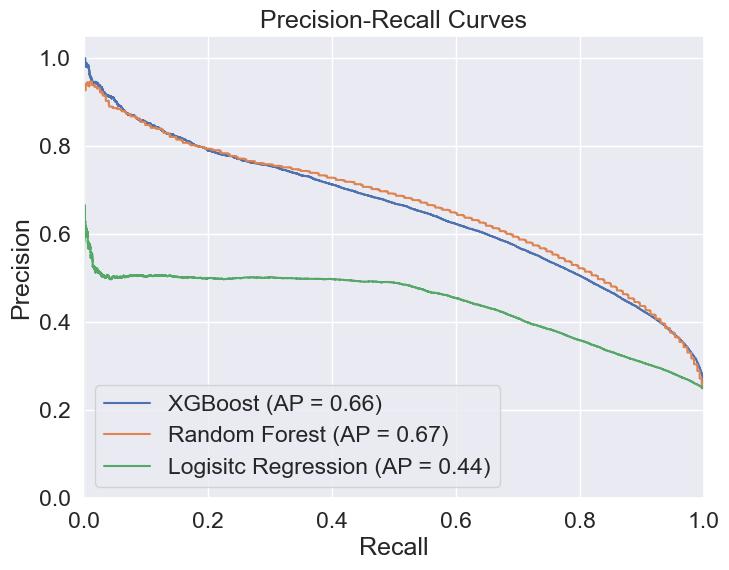

In [43]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import label_binarize
from sklearn.metrics import precision_recall_curve, average_precision_score
from sklearn.ensemble import RandomForestClassifier


# Store probabilities in a dictionary
probs = {
    'XGBoost': xgb_probs,
    'Random Forest': rf_probs,
    'Logisitc Regression': lr_probs
}

# Calculate precision, recall, and average precision for each classifier
precision = dict()
recall = dict()
average_precision = dict()

for clf_name, clf_probs in probs.items():
    y_test_bin = label_binarize(y_test, classes=np.unique(y_test))
    precision[clf_name], recall[clf_name], _ = precision_recall_curve(y_test_bin.ravel(), clf_probs.ravel())
    average_precision[clf_name] = average_precision_score(y_test_bin, clf_probs, average="micro")

# Plot the precision-recall curves for all classifiers
plt.figure(figsize=(8, 6))

for clf_name in probs.keys():
    plt.step(recall[clf_name], precision[clf_name], where='post',
             label='{} (AP = {:.2f})'.format(clf_name, average_precision[clf_name]))

plt.xlabel('Recall')
plt.ylabel('Precision')
plt.ylim([0.0, 1.05])
plt.xlim([0.0, 1.0])
plt.title('Precision-Recall Curves')
plt.legend(loc='lower left')
plt.grid(True)
plt.show()